# Busqueda y Optimización con Estrategias evolutivas

**  El notebook está diseñado para no tener que ser ejecutado. Todos los videos, tablas o graficos necesarios estan cargados desde local para poder ser vistos. Es importante tener la carpeta de resultados para verlos. Todas las celdas son ejecutables para ver que correstamente funciona y no hay problema de borrado de datos. Si esa ejecución ya existe, dará un error en el guradado de resultados y no modificará los presentados. Todas las ejecuciones aparte de almacenarlos los muestra por pantalla para confirmar que funcionan

En esta práctica vamos a explorar las *Estrategias evolutivas* para solucionar un problema de optimización real. 

El problema propuesto a solucionar es un problema de optimización de un brazo robótico.  

El problema consiste en la optimización de los ángulos de un brazo robotico con 10 puntos de movimiento.

A diferencia del problema anterior los valores pueden ser negativo y decimales es por ello que los algoritmos genéticos no nos sirven y tenemos que optar por este tipo de estrategias.

Los valores de cada individuo en las estrategias con 10 valores que se mueven entre los rangos -180 y 180.

In [1]:
import numpy as np
import requests
import pylab as pl
import matplotlib.pyplot as plt
from IPython import display
import os
from IPython.display import Image
! pip install imageio
import imageio
import random
import string
import math
import pandas as pd

You should consider upgrading via the '/Library/Frameworks/Python.framework/Versions/3.8/bin/python3 -m pip install --upgrade pip' command.


Para resolver este problema se van a utilizar dos estrategías diferentes. 

La primera de ellas es una estrategia con un solo individuo que se determina en función de las variables que lo determinan (los 10 valores de los ángulo del brazo robótico) más un verctor de varianzas del mismo tamaño que determina la mutación de las variables que lo definen. Estas varizanzas tambien mutan a lo largo del proceos de búsqueda de la solución optima. A diferencia de lo que hemos visto en la parte de Algoritmos Genéticos, en las estrategias de un solo individuo no existe ni selección ni cruce. Solo modificamos el individuo si el generado en cada iteración es mejor que el anterior. 

La segunda estrategia será explicada más adelante. De estragias múltiples se van a probar la (µ, λ) y la (µ + λ)

## 1 + 1

In [59]:
class EE11:
    def __init__(self,size, initial_variances = [10,100]):

        self.cd = 0.82
        self.ci = 1.82

        self.initial_variances = initial_variances

        self.size = size
        
        self.movements = []
        self.fitness = []

        self.avoid_minimum_fitness = []

        self.father = {'variables': [], 'desviaciones':[], 'fitness':-1}
        self.__random_father_initialization(size)

        self.son = {'variables': [], 'desviaciones':[], 'fitness':-1}

        self.figures = []

        self.times_minimum_avoided = []

        

    def __ind_to_string(self,ind):
        st = ''
        for number, x in enumerate(ind['variables']):
            st += 'c{}={}&'.format(number + 1, x)
        return st[:-1]
        
    def __fit(self,ind):
        url = 'http://memento.evannai.inf.uc3m.es/age/robot10?'
        back = requests.get(url + self.__ind_to_string(ind))
        return float(back.text)
        


    def __random_father_initialization(self,size): 
        individuo = {'variables': [], 'desviaciones':[],'fitness': -1}
        varianzas = np.random.uniform(low=self.initial_variances[0], high=self.initial_variances[1], size=(size)).tolist()
        variables = []
        for var in varianzas:
            variables.append(np.random.normal(loc = 0, scale = var))
        individuo['variables'] = np.array(variables)
        individuo['desviaciones'] = np.array(varianzas)
        individuo['fitness'] = self.__fit(individuo)
        self.father = individuo

    def __mutation_trial(self):
        new_ind =  {'variables': [], 'desviaciones':[], 'fitness':-1}
        vars  = []
        for var,des in zip(self.father['variables'],self.father['desviaciones']):
            vars.append(np.random.normal(loc = var, scale = des))
        new_ind['variables'] = np.array(vars)
        new_ind['fitness'] = self.__fit(new_ind)
        new_ind['desviaciones'] = self.father['desviaciones']
        self.son =  new_ind

    def __avoid_minumm(self,ind):
        ind['desviaciones'] = np.array(np.random.uniform(low=10, high=100, size=(len(ind['desviaciones'] ))).tolist())
        print(ind['desviaciones'])
        return ind 
    
    def __save_training(self,folder): 
        path = os.path.join('resultados/EstrategiasEvolutivas', folder)
        os.mkdir(path)
        video_path = os.path.join(path, 'video.gif')
        imageio.mimsave(video_path, self.figures,fps=2)
        images_path = os.path.join(path, 'images')
        os.mkdir(images_path)
        os.chdir(images_path)
        for epoch,image in enumerate(self.figures):
            imageio.imwrite('image_epoch_printed_number{}.jpg'.format(epoch + 1),image)
        os.chdir("../../../..")
    
    
    def __plot_training(self,epoch):
        
        fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(16, 7))
        fig.suptitle('EE search: epoch {}'.format(epoch))
        
        text_kwargs = dict(ha='center', va='center', fontsize=15, color='blue')

        ax1.plot(range(0,epoch + 1),self.fitness, label='Best Value',color = 'blue')
        ax1.set_title('Individual fitness')
        #ax1.annotate('{}'.format(round(self.father['fitness'],2)),(epoch,self.fitness[-1]))
        ax1.text(epoch*0.49, ax1.get_ylim()[1] * 0.80,'{}'.format(round(self.father['fitness'],2)), **text_kwargs)
        ax1.legend()
        
        ims_plot = ax2.imshow([self.father['variables'].tolist()],cmap = plt.cm.twilight, vmax=255, vmin=-255)
        ax2.set_title('Individual Values')
        ax2.axis('off')
        plt.colorbar(ims_plot)

        fig.canvas.draw()       # draw the canvas, cache the renderer
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        self.figures.append(image)

        display.clear_output(wait=True)
        display.display(pl.gcf())
        
        
    def search(self,epochs, convergence_strategy = 'avoid_minimum', mode = 'no_plot'):
        letters = string.ascii_lowercase
        
        
        for epoch in range(epochs):
            #print('Father {}, Son {}'.format(father,son))
            if(epoch%10==0): print('Epoch {} Father Fitness {}'.format(epoch,self.father['fitness']))
            self.fitness.append(self.father['fitness'])
            self.avoid_minimum_fitness.append(self.father['fitness'])
            self.__mutation_trial()
            #print('Son fitness {}'.format(son['fitness']))
            if (self.son['fitness'] < self.father['fitness']):
                if (int(self.son['fitness']) < int(self.father['fitness'])):
                    self.movements.append(True)
                    #print('Changing son and setting to true')
                else:  
                    self.movements.append(False)
                    #print('Changing son and setting to true')
                self.father = self.son
            else:
                self.movements.append(False)
            
            if (epoch > 10):
                proportion = self.movements[-10:].count(True)/10
                #print(movments[-10:],proportion)
                if(proportion < 0.2):
                    #print('Proportion low - {}'.format(cd))
                    #print('Previous deviations {}'.format(father['desviaciones']))
                    self.father['desviaciones'] = self.cd * self.father['desviaciones']
                    #print('New deviations {}'.format(father['desviaciones']))
                    if (convergence_strategy == 'avoid_minimum' and epoch > 500 and len(self.avoid_minimum_fitness) > 20 and (sum(self.avoid_minimum_fitness[-20:]) / 20) - self.avoid_minimum_fitness[-1]): 
                        self.avoid_minimum_fitness = []
                        self.times_minimum_avoided.append(epoch)
                        print('Minimum Avoided')
                        self.father = self.__avoid_minumm(self.father)
                elif (proportion > 0.2):
                    #print('Proportion high - {}'.format(ci))
                    self.father['desviaciones'] = self.ci * self.father['desviaciones']
            
            if (mode == 'plot' and epoch > 0 and (self.movements[-1] or epoch == epochs - 1)): self.__plot_training(epoch)
        if(mode == 'plot'):
            name = 'EE_11_CE{}_E_{}_{}'.format(convergence_strategy,epochs,''.join(random.choice(letters) for i in range(5)))
            self.__save_training(name)
            return name


El nombre de los fincheros tiene este formato. 'EE_11_CE{}_E_{}_{}'

* CE es el convergence strategy. Puede ser none o avoid minimun que más adelante se verá su significado.
* E el numeor de épocas de la búsqueda
* El ultimo valor es el número de épocas.

In [ ]:
prueba_inversa = EE11(10)
video = prueba_inversa.search(500,convergence_strategy = 'None',  mode = 'plot')

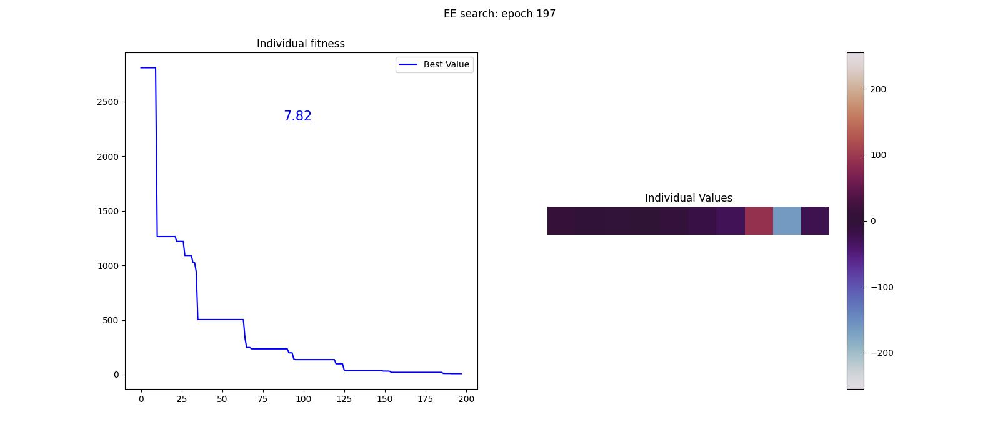

In [9]:
Image("resultados/EstrategiasEvolutivas/" + "EE_11_CENone_whhtn/images/image_epoch21.jpg")

Podemos apreciar en la ejecución primera de la búsqueda con el algoritmo 1+1 que el valor obtenido es bastante bueno. Con solo 500 iteraciones (no son muchas ya que en cada iteración solo se genera y calcula el fitness de 1 individuo) la solución en contrada es bastante buena. Una cosa que no se puede apreciar en este gráfico, ya que solo se plotea en este caso cuando el individuo a mejorado, es el final de la busqueda. A partir de la iteración 200 el algoritmo se ha quedado estancado en un mínimo local hasta la iteración 500 sin realizar ningun movimiento. Despues de varias pruebas esto es algo que se da con frecuencia, más adelante se planetea una técnica para evitar o "escapar" de dicho problema.

In [ ]:
prueba_inversa = EE11(10)
video = prueba_inversa.search(500,convergence_strategy = 'None',  mode = 'plot')

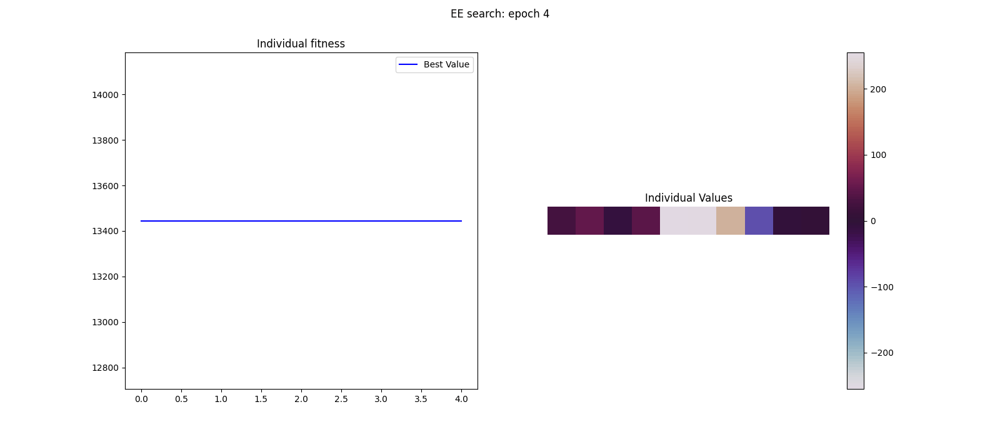

In [16]:
Image("resultados/EstrategiasEvolutivas/" + "EE_11_CENone_faonz/video.gif")

En este último ejemplo se puede apreciar que desde la iteración 100 a la 200 se han producido pequeñas moficaciones pero a partir de la 200 no ha habido movimiento del individuo principal. Los individuos generados son siempre peores. El algoritmo se ha quedado estancado en un mínimo local del cual no es capaz de salir. 

In [20]:
prueba_inversa.father['desviaciones']

array([1.38492318e-27, 2.41257061e-27, 2.25931097e-27, 2.14847797e-27,
       2.43321612e-27, 1.69099155e-27, 1.94491617e-27, 2.24901844e-27,
       6.03479683e-28, 1.75024365e-27])

Una de los motivos por los cuales el algoritmo no es capaz de salir es el tamaño minimo que tienen las varianzas. Los nuevos individuos generados que pueden sustituir al padre son idénticos a este por lo tanto su fitness es igual. Existen muchas formas de solventar este problema. La planteada se ha denominada avoid_minimum y se puede pasar como parámetro de la función de búsqueda con el atributo convergence_strategy. Esta funcionalidad detecta a partir de un número X (100) de iteraciones si la búsqueda se ha quedado estancada en un punto concreto sin actualizar el fitness. Si es así se van a reinicializar los valores de las varianzas a unos valores similares a los inciales. Con esto lo que se busca es que el algritmo sea con cierta probabilidad capaz de encontrar dentro del espacio de soluciones un punto diferente, menor que el anterior que pueda dar a un mínimo local mejor y más optimo para la búsqueda. A partir de la época 100, cada 20 épocas si el valor de fitness no se ha modificado el algotirmo volverá a inicializar las varianzas.   

Poniendo el foco en la siguiente imagen. Nuestra búsqueda se puede haber quedado estancada en el punto A, mínimo local de la función de fitness, si este individuo tiene unas varianzas muy pequeñas es imposible, segun esta definida la mutación en este algoritmo, que salga de este punto. Con la ténica de avoid mínimum lo que queremos es que la busqueda sea capaz de encontrar un mejor individuo (punto azul) que permita a la busqueda encontrar otro mínimo local mejor (puntos rojos) o el mínimo global (punto verde).

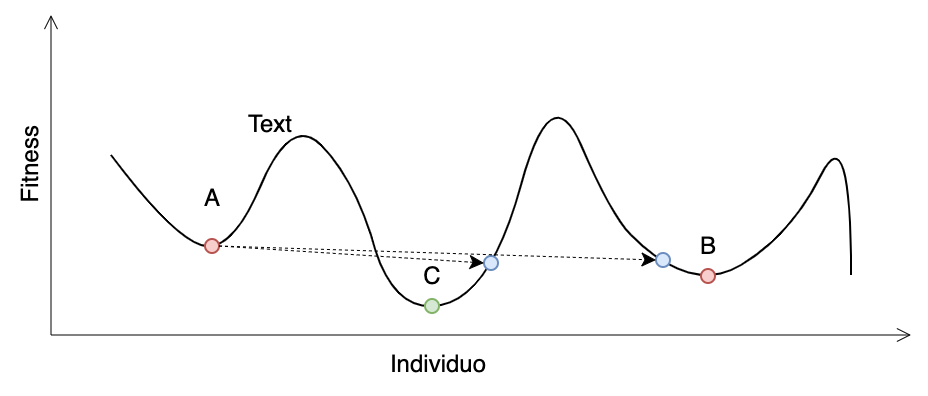

In [24]:
Image("AvoidMinimum.drawio.png")


In [ ]:
prueba_inversa = EE11(10)
video = prueba_inversa.search(500,convergence_strategy = 'avoid_minimum',  mode = 'plot')

El siguiente array muestra las épocas en las cuales la función de avoid minimum ha corregido el valor de las varianzas.

In [39]:
np.array(prueba_inversa.times_minimum_avoided)

array([107, 135, 158, 179, 200, 221, 242, 263, 284, 305, 326, 347, 368,
       389, 410, 431, 452, 473, 494])

Si comprobamos el fitness del individuo despues de esas iteraciones en el video, podemos apreciar que ha sabido encontrar mejores puntos sobre los cuales conducir la búsqueda. El algoritmo no ha encontrado la solución óptima pero parace que es capaz de salir de los puntos que hacían que se quedarse estático en cierto punto. 

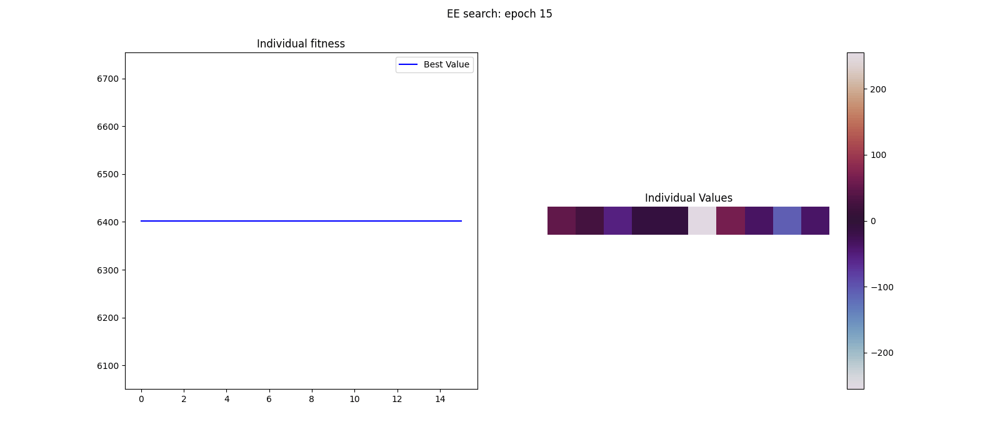

In [37]:
Image("resultados/EstrategiasEvolutivas/" + "EE_11_CEavoid_minimum_ikcpe/video.gif")

Vamos a realizar una prueba con 3.000 épocas, para comprobar si el mñetodo de optimización desarrollado funciona y permite al algoritmo una busqueda de valores de fitness bajos.

In [ ]:
prueba_inversa = EE11(10)
video = prueba_inversa.search(3000,convergence_strategy = 'avoid_minimum',  mode = 'plot')

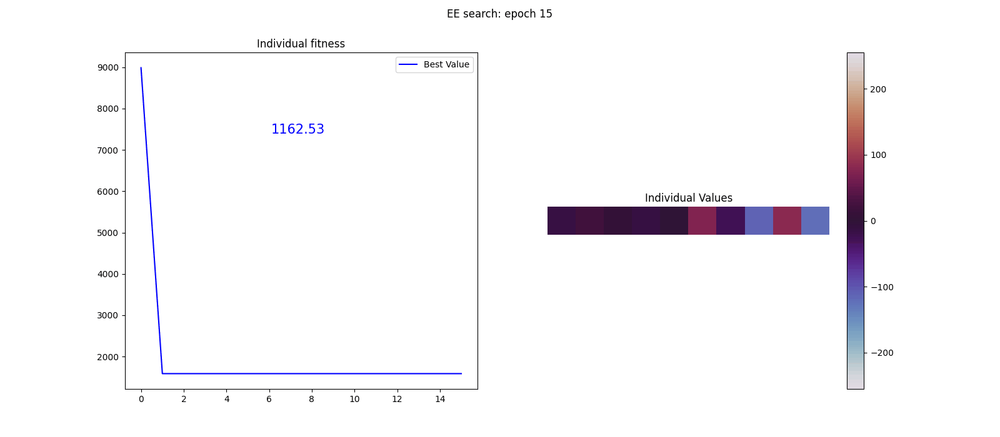

In [43]:
Image("resultados/EstrategiasEvolutivas/" + "EE_11_CEavoid_minimum_E_3000_yyzvz/video.gif")

El video anterior demuestra que el método desarrollado no es tan bueno como se esperaba. Desde la época 156 hasta la 3000 la búsqueda no ha sido capaz de encontrar un mejor indivio. Cuando el valor en si del individuo padre es muy bueno (12,95) la probabilidad de encontrar uno mejor con la exploración implementada es muy baja. Al final, liberar los varianzas lo que nos permite es una busqueda aleatoria controlada cercano al valor mejor encontrado (se han estipulado varianzas aleatoras entre 10 y 100) que es practicamente igual que una busqueda aleatoria desde el inicio pero asegurando el valor del individuo ya encontrado. 

Todas las pruebas anteriores se han realizado al parecer con una dirección que coge solo esta usando los valores de los primeros 4 atributos. 'http://memento.evannai.inf.uc3m.es/age/robot4?' a partir de este punto se ha modificado la dirección para que coja los 10 valores a optimizar.  Se va a realizar una prueba individual con esta nueva función.

In [ ]:
prueba_inversa = EE11(10)
video = prueba_inversa.search(500,convergence_strategy = 'avoid_minimum',  mode = 'plot')

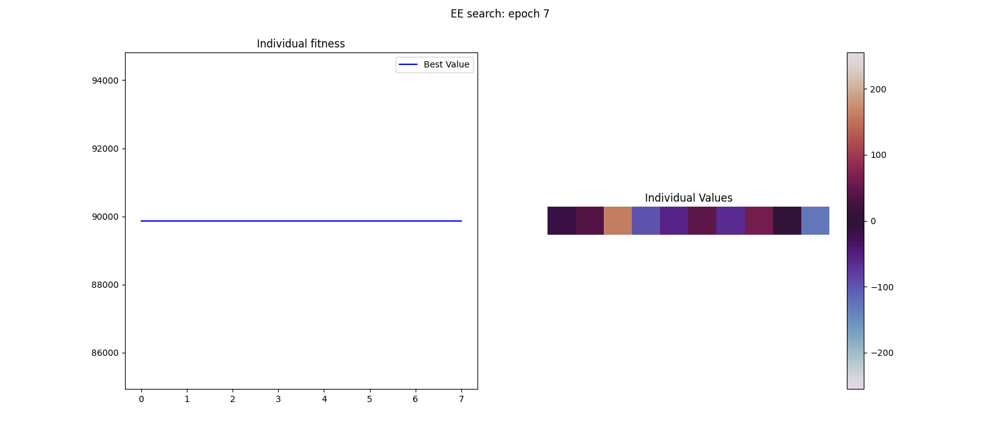

In [48]:
Image("resultados/EstrategiasEvolutivas/" + "EE_11_CEavoid_minimum_E_500_jhyii/video.gif")

Si nos fijamos en los gráficos anteriores a la modificación de la llamada a la función de fitness solo los primeros 4 valores siempre convergían a valores cercanos a 0. En una sola ejecución probada con el fitness valor 10 podemos ver como esto ha cambiado. A parte de inicializar en valores de fitness mucho más altos y tardar mucho más en converger los valores estan convergiendo todos. Parece que 500 ejecuciones son pocas para que el modelo converja. Las pruebas tipo van a pasar a tener 1.000 en lugar de 500.

Se ha decidido no volver a realizar las pruebas con 10 en lugar que con 4 ya que las pruebas realzias no estan afectadas por el número de variable a usar. En cambio, para determinar si el método diseñado para evitar minimos locales funciona de verdad se va a realizar la búsqueda con 1000 épocas 20 veces sin y con el optimizador con la función al completo.

Debido al cambio de comportamiento en la convergencia del modelos con todas las variables se ha modificado el valor de inicio del avoid_minimum a 500. Hasta esa época no se reinicilizarán las varianzas del individuo.

In [44]:
def retreive_fitness(element):
    return element.father['fitness']

In [ ]:
modelos = []
for i in range(20):
  modelos.append(EE11(10))

for value,model in enumerate(modelos):
    print('Entrenando modelo {}'.format(value))
    model.search(1000, convergence_strategy = 'None' ,mode = 'no_plot')

In [60]:
modelos_convergence = []

for i in range(20):
  modelos_convergence.append(EE11(10))

for value,model in enumerate(modelos_convergence):
    print('Entrenando modelo {}'.format(value))
    model.search(1000, convergence_strategy = 'avoid_minimum' ,mode = 'no_plot')

Epoch 680 Father Fitness 124.898979702
Epoch 690 Father Fitness 124.898979702
Minimum Avoided
[35.7477322  13.90994654 81.94266717 98.74567649 21.67198631 26.1757145
 57.07089238 21.97983223 88.53360384 66.94318682]
Epoch 700 Father Fitness 124.898979702
Epoch 710 Father Fitness 124.898979702
Minimum Avoided
[83.11655902 73.73034345 75.31993015 75.51649244 51.93908129 81.35890173
 96.74774483 66.05902837 96.2167647  85.02769679]
Epoch 720 Father Fitness 124.898979702
Epoch 730 Father Fitness 124.898979702
Minimum Avoided
[79.1365058  92.09494501 73.69248067 33.65026608 77.55307593 98.66839645
 77.02464537 83.1046366  50.3436846  47.9230426 ]
Epoch 740 Father Fitness 124.898979702
Epoch 750 Father Fitness 124.898979702
Minimum Avoided
[35.51934056 69.04502664 74.26489119 64.59175514 92.97105781 89.14985375
 25.94414349 79.77248357 87.16339504 76.47800977]
Epoch 760 Father Fitness 124.898979702
Epoch 770 Father Fitness 124.898979702
Minimum Avoided
[97.63043007 29.70701472 43.74593472 42

In [62]:
df = pd.DataFrame(np.array([retreive_fitness(element) for element in modelos_convergence]))

In [65]:
for model in modelos_convergence:
    print(model.times_minimum_avoided)

[501, 522, 548, 573, 603, 625, 653, 682, 703, 724, 745, 766, 787, 808, 829, 850, 871, 892, 913, 934, 955, 976, 997]
[]
[512, 535, 556, 584, 605, 626, 652, 676, 703, 743, 764, 785, 806, 827, 848, 869, 898, 920, 941, 962, 983]
[501, 527, 548, 574, 598, 619, 640, 661, 692, 713, 740, 761, 782, 803, 824, 845, 866, 887, 908, 929, 950, 971, 992]
[501, 522, 543, 564, 585, 606, 627, 648, 669, 690, 711, 732, 753, 784, 805, 835, 863, 884, 905, 926, 947, 968, 989]
[501, 526, 551, 572, 593, 614, 635, 675, 696, 717, 738, 773, 794, 815, 836, 857, 878, 899, 920, 941, 962, 983]
[501, 522, 543, 564, 595, 618, 649, 670, 691, 712, 733, 754, 775, 796, 817, 838, 859, 880, 901, 922, 943, 964, 985]
[501, 522, 550, 571, 592, 613, 634, 655, 676, 697, 718, 739, 760, 782, 803, 824, 858, 879, 900, 921, 942, 963, 984]
[501, 526, 552, 573, 594, 615, 636, 657, 678, 699, 720, 741, 762, 783, 804, 825, 846, 867, 888, 909, 930, 951, 972, 993]
[501, 522, 543, 564, 585, 606, 632, 667, 689, 710, 731, 752, 773, 794, 815, 836

In [64]:
df.to_csv('resultados/EstrategiasEvolutivas/1+1_20_1000_yesavoidoptimum.csv')

In [67]:
datos = np.array(pd.read_csv('resultados/EstrategiasEvolutivas/1+1_20_1000_noavoidoptimum.csv')['0'])
datos_avoid = np.array(pd.read_csv('resultados/EstrategiasEvolutivas/1+1_20_1000_yesavoidoptimum.csv')['0'])

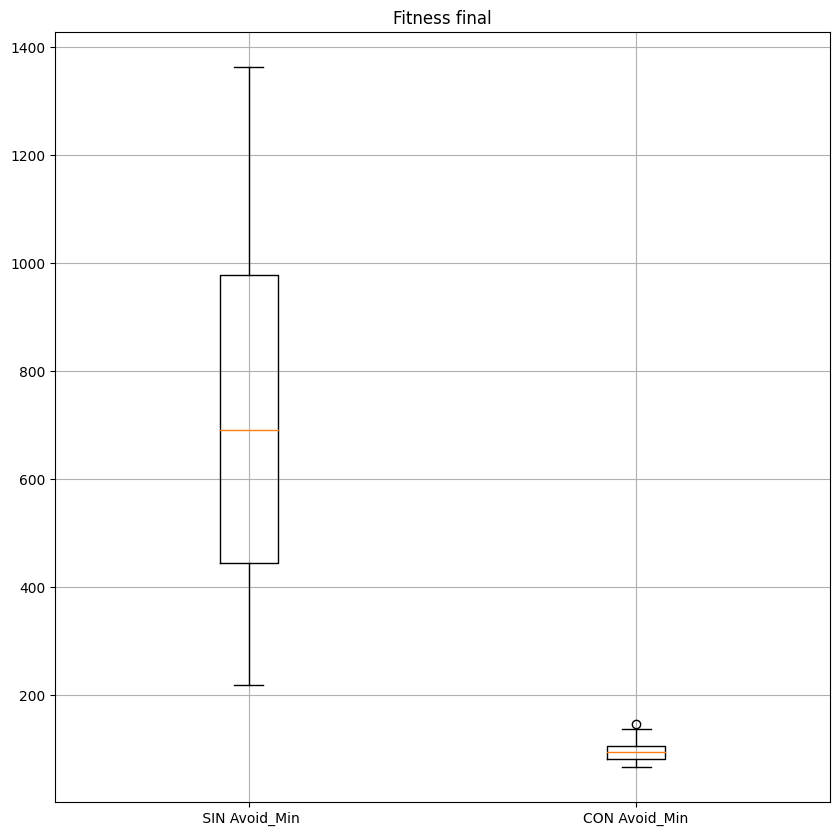

In [68]:
fig = plt.figure(figsize=(10, 10))
plt.boxplot([datos,datos_avoid], labels = [' SIN Avoid_Min','CON Avoid_Min'])
plt.title('Fitness final')
plt.grid()

En el grafico de arriba podemos apreciar valores finales de las 20 ejecuciones de la estrategia 1+1 para este problema con y sin minimum avoidance. Podemos apreciar que el modelo con minimum avoidance es significativamente mejor ya que el peor de los resultados, valorado como outlier, es mejor que el mejor de los resultados sin avoid minimum.


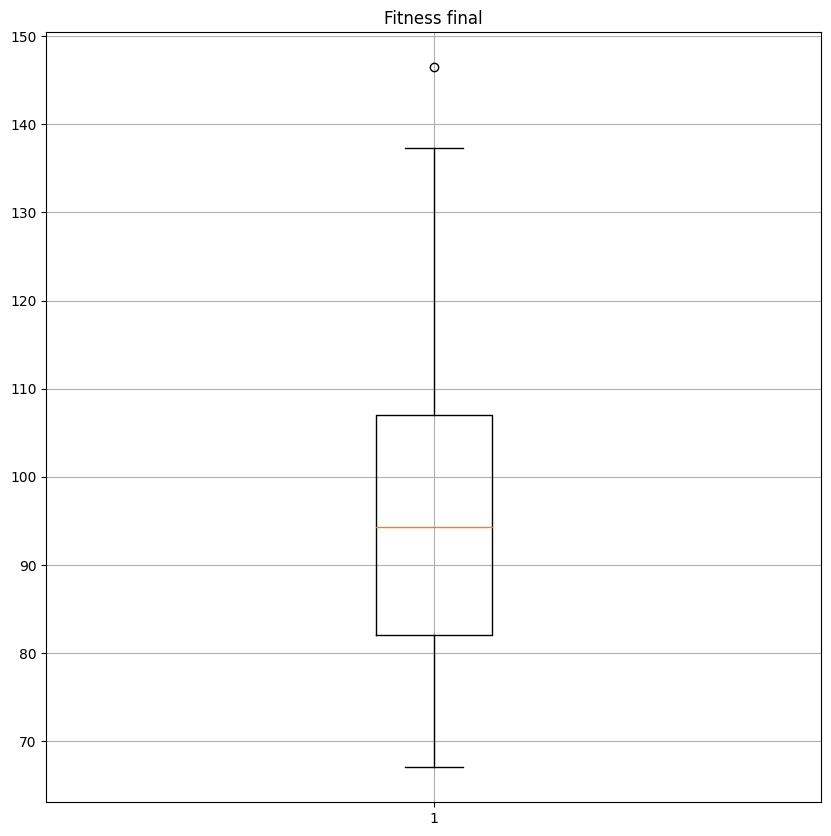

In [75]:
fig = plt.figure(figsize=(10, 10))
plt.boxplot(datos_avoid)
plt.title('Fitness final')
plt.grid()

Vemos que el algoritmo 1+1 con avoid es bastante bueno pero esta lejos de converger a la solución óptima y es por ello que se han implementado las estrategias de (µ + λ) y  (µ, λ). El problema de estrategias con un solo individuo es que las búsquedas con espacios de soluciones tan grandes van a depender mucho de la suerte del valor inicial y del número de ejecuciones del mismo algortimo que se hagan.

##  (µ, λ) & (µ + λ)

Las estrategias múltiples evolutavas inttroducen el concepto de población a la busqueda y con ello las estrategias de selección y cruce de individuos para generar las nuevas poblaciones.

De estas estrategias se han implementado dos -> (µ, λ) y (µ + λ)

La diferencia entre ambas estrategias es poca, unicamente radica en la selección de la nueva población una vez se selecciona, cruza y muta a los nuevos individuos. En al caso de (µ + λ) se unifican los nuevos individuos y la población anterior y se escoge a los mejores para la siguiente. En el caso de (µ, λ) se eliminan de la población previa tantos como se vaya a insertar, independientemente de que sean mejores o no.

Para simplificar las posibilidades se ha elegido siempre el cruce de unicamente dos individuos. De los seleccionados siempre se cruzan por orden de selección (toernos aleatorios) resulatndo en la mitad de individuos nuevos que de individuos en la población. 


Para el método de selección ademas de implementar el torneo se ha implementado la rouleta donde cada individuo tiene la probabilidad de ser escogido proporcional al fitness comparado con el resto de la población de esta forma, el que más tiene mas probabilidades tiene de ser elegido.

En el caso de mutación se han desarrollado tres variantes. Se han denominado exponential, que usa la fórmula vista en clase donde las varianzas se multiplican por la exponencial elevado a la gausiana centrada en 0 con desviación teta, la identidad, similar a la anterior pero eliminando el exponencial  y la 'solo variables' donde las varianzas no mutan, solo mutan los valores del individuo y se heredan las del individuo sin mutar.

Con todas estas posibilidades y más que se han dejado fuera se podría hacer una batería muy completa de pruebas. Se van aa relaizar las mas posibles modificando además el tamaño de la población.

In [86]:
class MultipleEE:
    def __init__(self,population_size, individual_size):
        self.population_size = population_size
        self.individual_size = individual_size

        self.population = []

        self.fitness = []

        self.__random_population_init()

        self.figures = []

        self.razon_aprendizaje = 1/(math.sqrt(2* self.population_size))


    def __ind_to_string(self,ind):
        st = ''
        for number, x in enumerate(ind['variables']):
            st += 'c{}={}&'.format(number + 1, x)
        return st[:-1]
        
    def __fit(self,ind):
        url = 'http://memento.evannai.inf.uc3m.es/age/robot10?'
        back = requests.get(url + self.__ind_to_string(ind))
        return float(back.text)
        


    def __random_father_initialization(self,size): 
        individuo = {'variables': [], 'desviaciones':[],'fitness': -1}
        varianzas = np.random.uniform(low=0, high=250, size=(size)).tolist()
        variables = []
        for var in varianzas:
            variables.append(np.random.normal(loc = 0, scale = var))
        individuo['variables'] = np.array(variables)
        individuo['desviaciones'] = np.array(varianzas)
        individuo['fitness'] = self.__fit(individuo)
        return individuo
    
    
        

    def __random_population_init(self):
        for i in range(self.population_size):
            self.population.append(self.__random_father_initialization(self.individual_size))
        

    def __copulate(self,ind_father, ind_mother):
        individuo = {'variables': [], 'desviaciones':[],'fitness': -1}
        individuo['variables'] = (ind_father['variables'] + ind_mother['variables'])*0.5
        individuo['desviaciones'] = np.sqrt(ind_father['desviaciones'] + ind_mother['desviaciones'])
        individuo['fitness'] = self.__fit(individuo)
        return individuo

    def __copulate_population(self,intermidiate_pop):
        copulated_individuals = []
        for i in range(0,len(intermidiate_pop),2):
            copulated_individuals.append(self.__copulate(intermidiate_pop[i],intermidiate_pop[i+1]))
        return copulated_individuals


    def __mutation_trial(self,ind, epoch, type = 'just_variables'):
        new_ind =  {'variables': [], 'desviaciones':[], 'fitness':-1}
        vars  = []
        for var,des in zip(ind['variables'],ind['desviaciones']):
            vars.append(np.random.normal(loc = var, scale = des))
        new_ind['variables'] = np.array(vars)
        new_ind['fitness'] = self.__fit(new_ind)

        if(type != 'just_variables'): 
            new_variances = []
            if (type == 'exponential'): 
                for variance in ind['desviaciones'].tolist():
                    new_variances.append(math.e**(np.random.normal(loc = 0, scale = self.razon_aprendizaje)*variance))
            elif (type == 'identity'):
                for variance in ind['desviaciones'].tolist():
                    new_variances.append(np.random.normal(loc = 0, scale = self.razon_aprendizaje)*variance)
            new_ind['desviaciones'] = np.array(new_variances)
        else: new_ind['desviaciones'] = ind['desviaciones']

        return new_ind

    def __mutate_inter_pop(self,population, epoch, type = 'just_variables'):
        mutated = []
        for ind in population:
            mutated.append(self.__mutation_trial(ind,epoch, type = 'just_variables'))
        return mutated

    def __retreive_fitness(self,element):
        return element['fitness']

    def __roulette(self,sorted_population):
        max = sorted_population[-1]['fitness']
        values = []
        for element in sorted_population:
            values.append(int(max/element['fitness']))
        values = np.around(np.array(values))
        roulette = []
        for position,times in enumerate(values.tolist()):
            for i in range(times):
                roulette.append(position)
        random.shuffle(roulette)
        to_procreate = []
        for i in range(len(sorted_population)):
            to_procreate.append(sorted_population[roulette[random.randint(0,len(roulette) - 1)]])
        return to_procreate
    
    def __tournament(self,sorted_population, tournament_count, tournament_size):
        selected_for_coupling = []
        for i in range(tournament_count): #numero de toneos
            tournament_fitness = []
            tournament_selection = []
            for j in range(tournament_size): # tamaño de los torneos
                tournament_selection.append(sorted_population[random.randint(0,len(sorted_population)-1)])
            tournament_selection.sort(key = self.__retreive_fitness)
            selected_for_coupling.append(tournament_selection[0])
        return selected_for_coupling
    
    def __population_to_array(self):
        population = []
        porportion = int(self.population_size/self.individual_size)
        for individual in self.population:
            values = individual['variables'].tolist()
            out = []
            for value in values:
                        for i in range(porportion):
                                out.append(value)
            population.append(out)
        return population
    
    def __population_fitness(self):
        fitness = []
        for individual in self.population:
            fitness.append(individual['fitness'])
        return fitness
    
    def __plot_training(self,epoch):
        
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(16, 7))
        fig.suptitle('EE search: epoch {}'.format(epoch))
        
        text_kwargs = dict(ha='center', va='center', fontsize=15, color='blue')

        ax1.plot(range(0,epoch + 1),self.fitness, label='Best Value',color = 'blue')
        ax1.set_title('Population fitness')
        #ax1.annotate('{}'.format(round(self.father['fitness'],2)),(epoch,self.fitness[-1]))
        ax1.text(epoch*0.49, ax1.get_ylim()[1] * 0.80,'{}'.format(round(self.population[0]['fitness'],2)), **text_kwargs)
        ax1.legend()

        ax2.bar(range(0,self.population_size),self.__population_fitness())
        ax2.set_title('Individual fitness')
        
        ims_plot = ax3.imshow(self.__population_to_array(),cmap = plt.cm.twilight, vmax=255, vmin=-255)
        ax3.set_title('Individual Values')
        ax3.axis('off')
        plt.colorbar(ims_plot)

        fig.canvas.draw()       # draw the canvas, cache the renderer
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        self.figures.append(image)

        display.clear_output(wait=True)
        display.display(pl.gcf())
    
    def __save_training(self,folder): 
        path = os.path.join('resultados/EstrategiasEvolutivas', folder)
        os.mkdir(path)
        video_path = os.path.join(path, 'video.gif')
        imageio.mimsave(video_path, self.figures,fps=2)
        images_path = os.path.join(path, 'images')
        os.mkdir(images_path)
        os.chdir(images_path)
        for epoch,image in enumerate(self.figures):
            imageio.imwrite('image_epoch{}.jpg'.format(epoch + 1),image)
        os.chdir("../../../..")

    def search_MuAndLambda(self,epochs, selection_strategy = 'roulette', mutation = 'just_variables',mode = 'plot'):
        letters = string.ascii_lowercase
        for epoch in range(epochs):
            
            self.population.sort(key = self.__retreive_fitness)
            #print(population)
            print('Epoch {} - Max Fitness {}'.format(epoch,self.population[0]['fitness']))
            self.fitness.append(self.population[0]['fitness'])
            if (selection_strategy == 'roulette'): 
                copulated_pop = self.__copulate_population(self.__roulette(self.population))
            elif (selection_strategy == 'tournament'):
                copulated_pop = self.__copulate_population(self.__tournament(self.population,self.population_size,4))
            
            #print(copulated_pop)
            #print(population[:len(population)-len(copulated_pop)] + copulated_pop)
            self.population = self.population[:len(self.population)-len(copulated_pop)] + self.__mutate_inter_pop(copulated_pop, epoch, type = mutation)
            #print(population)
            if(epoch > 0 and mode == 'plot'): self.__plot_training(epoch)
        if(mode == 'plot'):
            name = 'EE_(µ, λ)_S{}_M{}_E{}'.format(selection_strategy,mutation,epochs)
            self.__save_training(name)
            return name
            
            

    def search_MuPlusLambda(self,epochs, selection_strategy = 'roulette',mutation = 'just_variables', mode = 'plot'):
        letters = string.ascii_lowercase
        self.population.sort(key = self.__retreive_fitness)
        for epoch in range(epochs):
            #print(population)
            print('Epoch {} - Max Fitness {}'.format(epoch,self.population[0]['fitness']))
            self.fitness.append(self.population[0]['fitness'])
            if (selection_strategy == 'roulette'): 
                copulated_pop = self.__copulate_population(self.__roulette(self.population))
            elif (selection_strategy == 'tournament'):
                copulated_pop = self.__copulate_population(self.__tournament(self.population,self.population_size,4))
            #print(copulated_pop)
            #print(population[:len(population)-len(copulated_pop)] + copulated_pop)
            intermidiate_pop = self.population + self.__mutate_inter_pop(copulated_pop, epoch, type = mutation)
            intermidiate_pop.sort(key = self.__retreive_fitness)
            self.population = intermidiate_pop[0:self.population_size]
            #print(population)
            if(epoch > 0 and mode == 'plot'): self.__plot_training(epoch)
        if(mode == 'plot'): 
            name = 'EE_(µ + λ)_S{}_M{}_E{}'.format(selection_strategy,mutation,epochs)
            self.__save_training(name)
            return name

Se va a relazir una bateria de pruebas combianndo las estraegias de selección y mutación apra ambos modelos para hacer una rápida comparación de que modelos son mejores. De momento se va a setear el numero de épocas a 20 para no hacer el proceso muy tedioso. De media las 20 ejecucuines rondan los 8 minutos.

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuAndLambda(20,selection_strategy='roulette',mutation = 'just_variables')

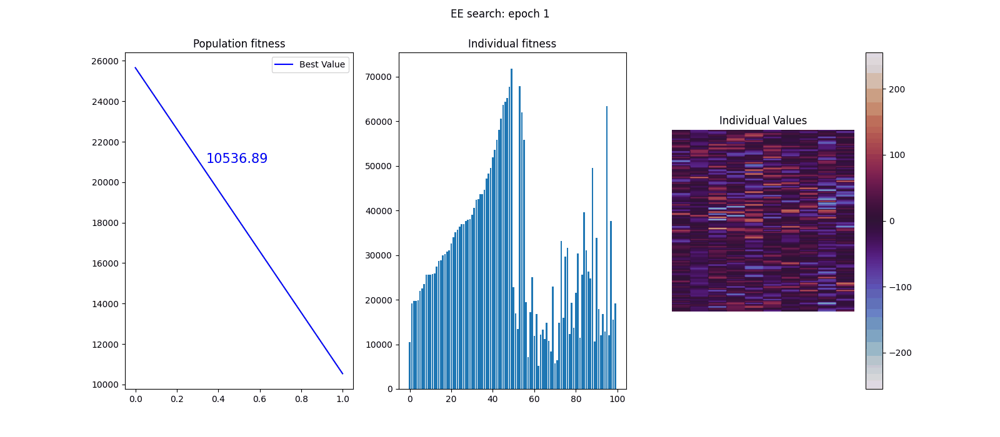

In [90]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Sroulette_Mjust_variables_E20/video.gif")

Es esta primere ejecución podemos apreciar que al unificar la mitad de la mejor población previa y los 50 nuevos individuos la grafica de individual fitness, al no necesitar un sort previo, esta dividida en estos conjuntos.

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuAndLambda(20,selection_strategy='roulette',mutation = 'exponential')

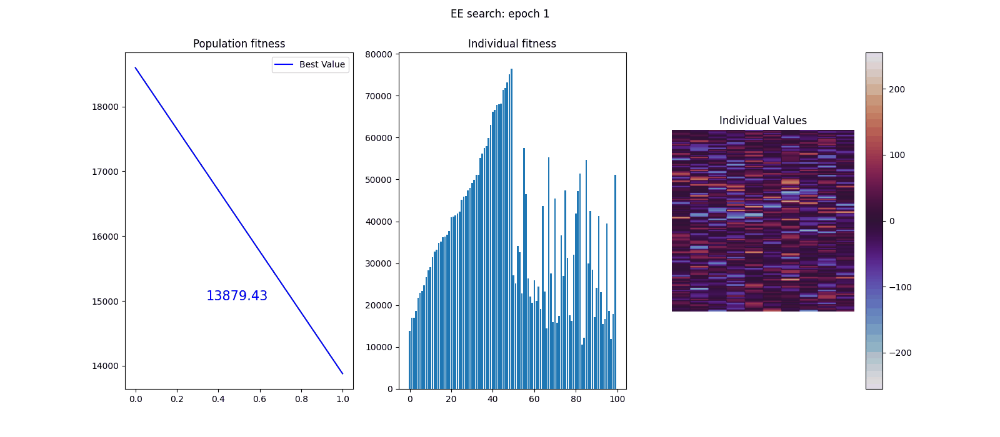

In [93]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Sroulette_Mexponential_E20/video.gif")

Una cosa a puntualizar es que las soluciones optimas parecen estar en los valores de los ángulos cercanos a 0 ya que tanto las primeras pruebas de estraegias múltiples como la estrategia 1+1 apuntan a esos números

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuAndLambda(20,selection_strategy='roulette',mutation = 'identity')

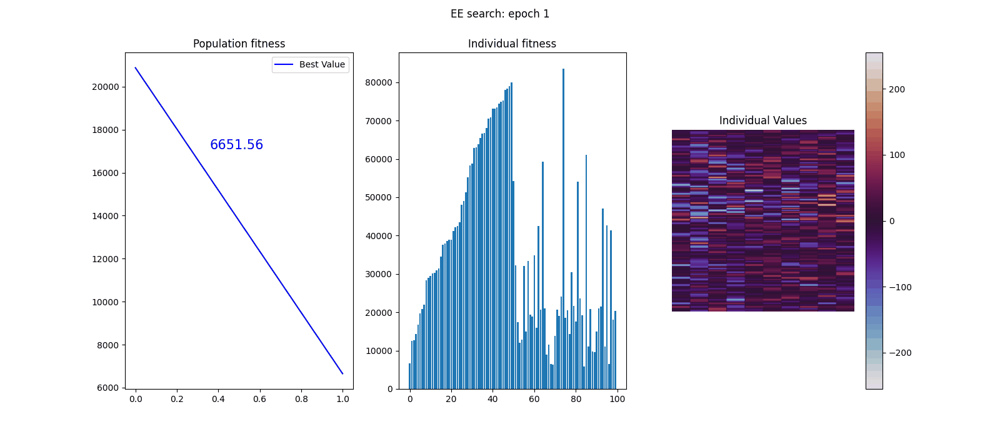

In [96]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Sroulette_Midentity_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuAndLambda(20,selection_strategy='tournament',mutation = 'just_variables')

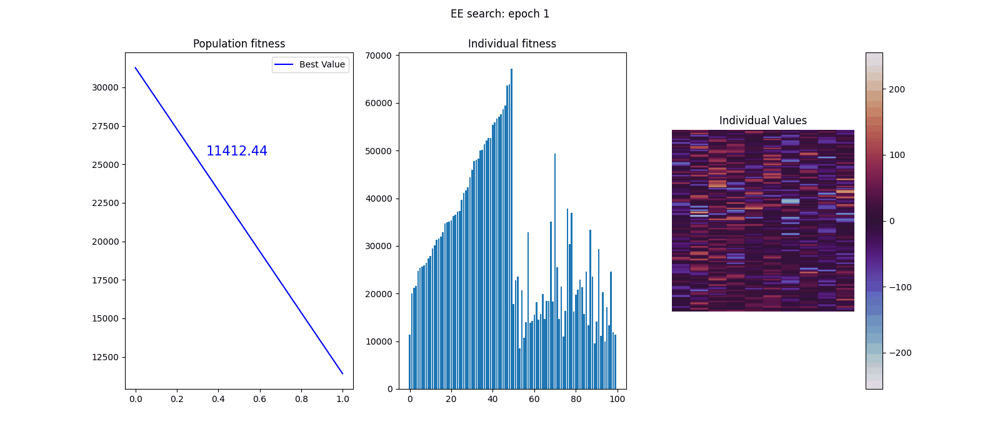

In [99]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Stournament_Mjust_variables_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuAndLambda(20,selection_strategy='tournament',mutation = 'exponential')

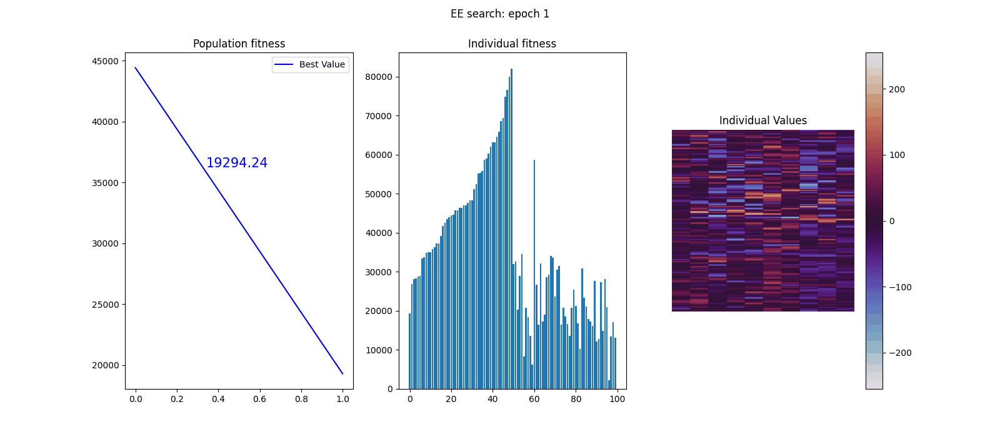

In [102]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Stournament_Mexponential_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuAndLambda(20,selection_strategy='tournament',mutation = 'identity')

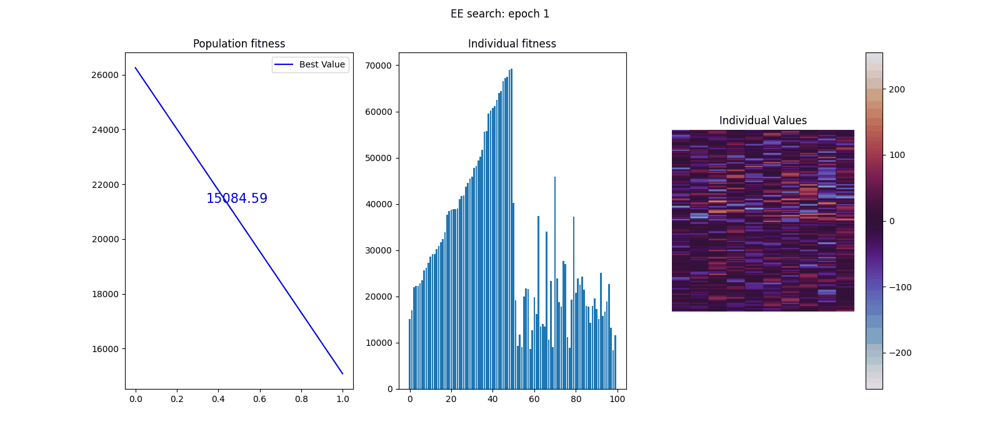

In [105]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Stournament_Midentity_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuPlusLambda(20,selection_strategy='roulette',mutation = 'just_variables')

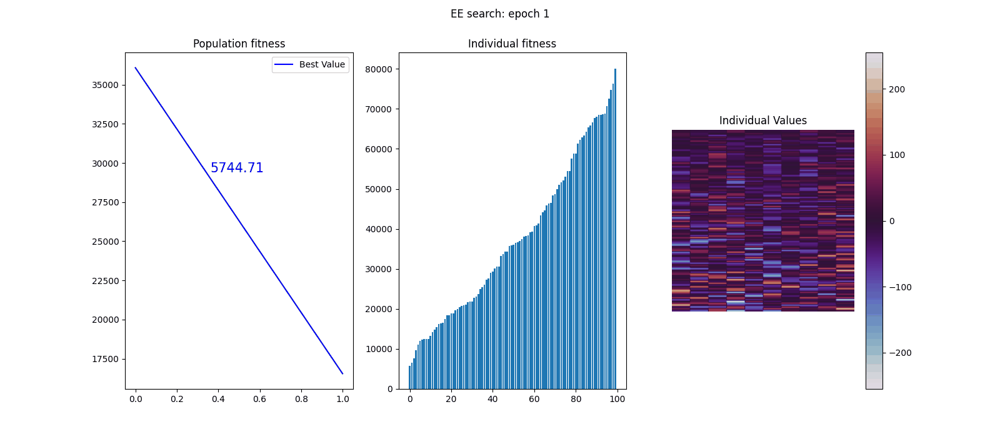

In [108]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Sroulette_Mjust_variables_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuPlusLambda(20,selection_strategy='roulette',mutation = 'exponential')

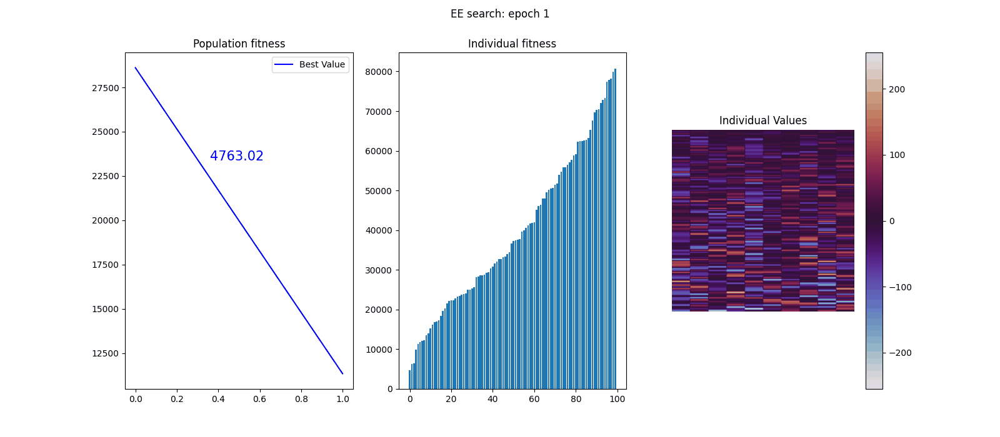

In [111]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Sroulette_Mexponential_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuPlusLambda(20,selection_strategy='roulette',mutation = 'identity')

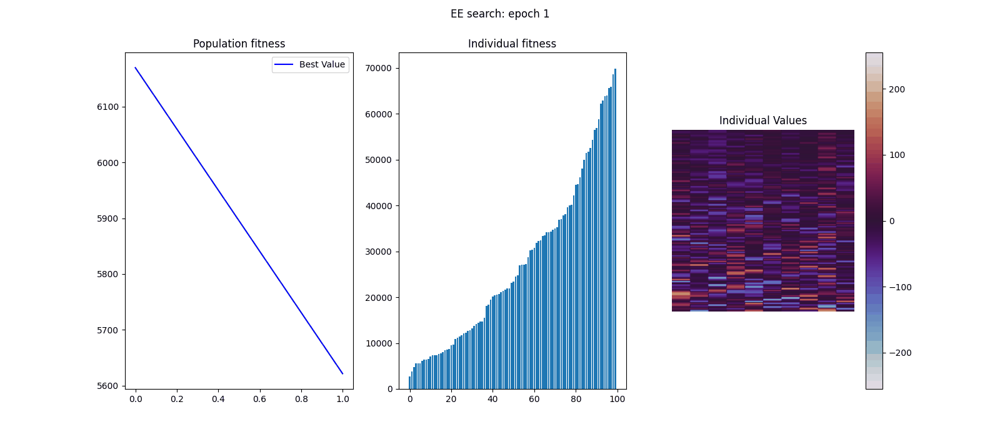

In [114]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Sroulette_Midentity_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuPlusLambda(20,selection_strategy='tournament',mutation = 'just_variables')

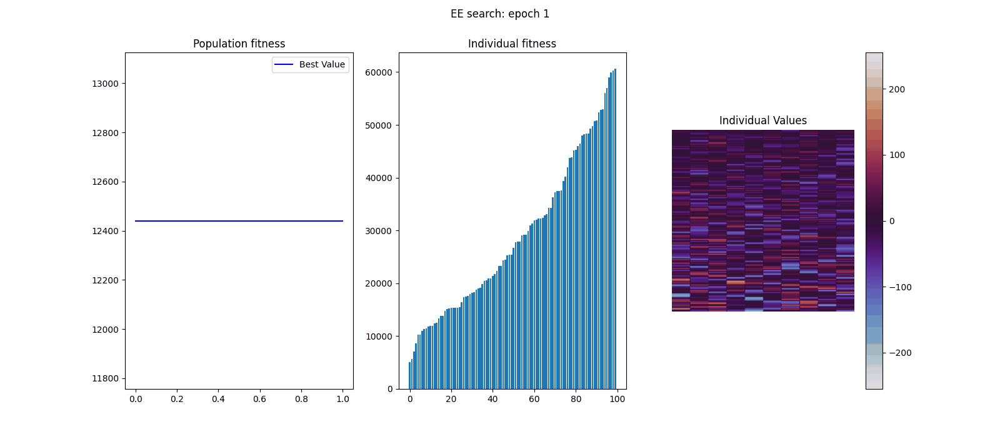

In [117]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Stournament_Mjust_variables_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuPlusLambda(20,selection_strategy='tournament',mutation = 'exponential')

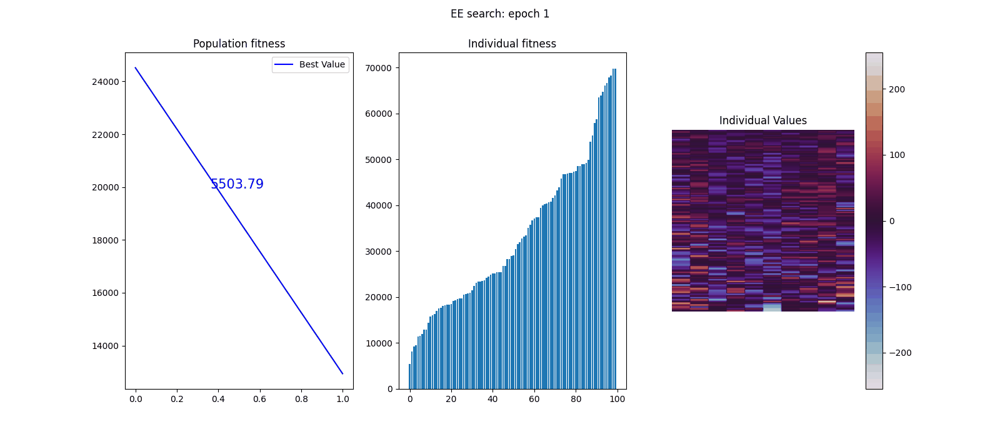

In [120]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Stournament_Mexponential_E20/video.gif")

In [ ]:
EE = MultipleEE(100,10)
name = EE.search_MuPlusLambda(20,selection_strategy='tournament',mutation = 'identity')

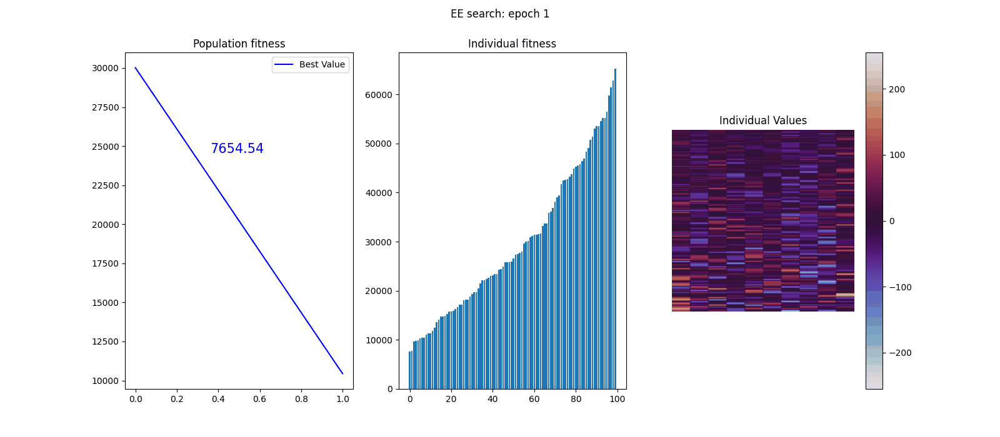

In [124]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Stournament_Midentity_E20/video.gif")

Del mejor entrenaiento, entendido como el menor valor obtenido en la epoca 20, se vuenve a hacer la búsqueda con población mucho mas grande para comparar los resultados. No es posible determinar con certeza que estos escogidos son los mejores modelo basandonose uno unicamente en una ejecución pero por el bien de la practica se escogen estos.

In [ ]:
EE = MultipleEE(500,10)
name = EE.search_MuAndLambda(20,selection_strategy='roulette',mutation = 'exponential')

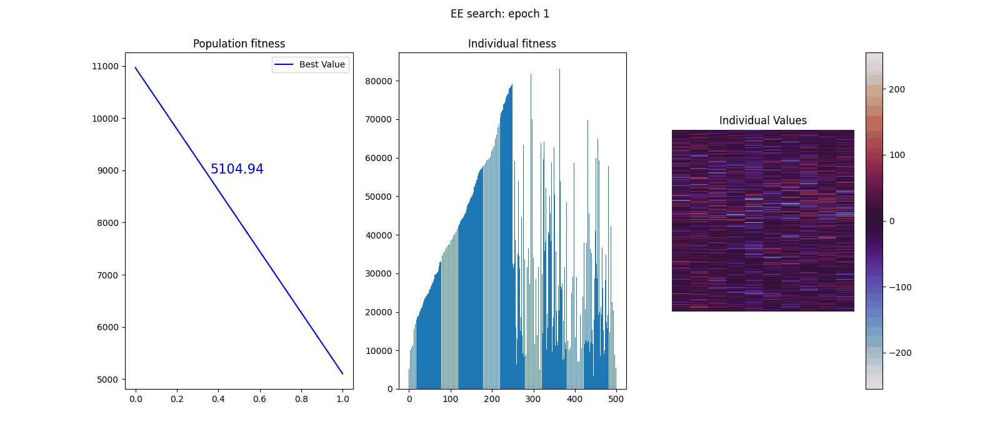

In [130]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ, λ)_Sroulette_Mexponential_E20_500/video.gif")

Si comparamos esta búsqueda con la anterior con 100 individuos podemos apreciar que converge más rapido y llega a un valor más bajo pero penalizando considerablemente el tiempo de ejecución.
Haciendo una bateria de pruebas podríamos identificar si es significativamente mejor que el modelo con solo 100 individuos. Con esta única ejecución no es suficiente.

In [ ]:
EE = MultipleEE(500,10)
name = EE.search_MuPlusLambda(20,selection_strategy='tournament',mutation = 'just_variables')

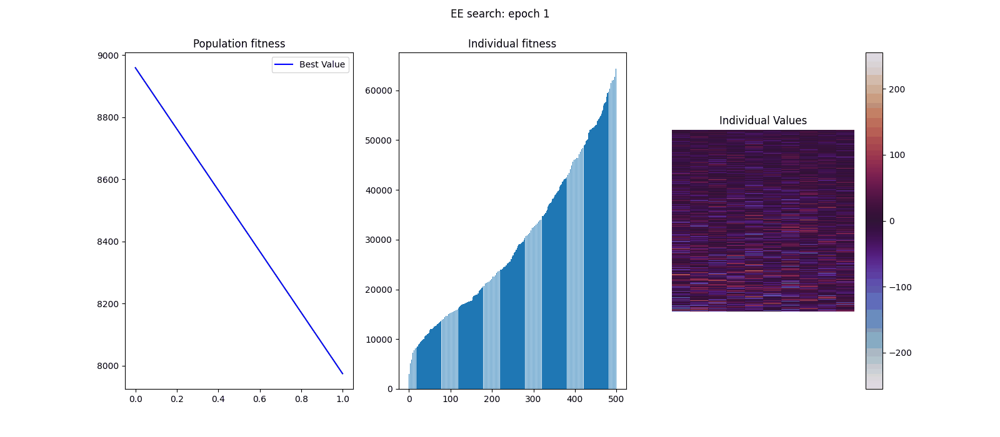

In [133]:
Image("resultados/EstrategiasEvolutivas/" + "EE_(µ + λ)_Stournament_Midentity_E20_500/video.gif")

La ultima ejecución del notebook plantea lo mimso que la anterior. Mejora los resultados y converge más rápido añadiendo mucho tiempo de computación.

### Trabajo futuro

Al igual que en la práctica 1 muchas ténnicas o posibilidades se han quedado por desarrollar por falta de tiempo.

- Inicialización no completamente pseudo - aleatoria.

- Probar con cruces con mas de dos individuos. El operador de cruce esta definido tal que es muy sencillo implementar un cruce entre mas de dos individuos al mismo tiempo.
    
- Mayor cantidad de pruebas con los ultimos modelos de estrategias múltiples para ver cual es más óptimo y comprobar como de cerca se puede quedar uno de 0 absoluto en esta práctica.